In [1]:
from __future__ import print_function, unicode_literals, absolute_import, division
import sys
import numpy as np
np.set_printoptions(threshold=sys.maxsize)

import copy
import matplotlib
matplotlib.rcParams["image.interpolation"] = 'none'
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

from glob import glob
import json
import gputools
from tqdm import tqdm
from tifffile import imread
from csbdeep.utils import Path, normalize
from sklearn.model_selection import train_test_split

from stardist import fill_label_holes, random_label_cmap, calculate_extents, gputools_available
from stardist.matching import matching, matching_dataset
from stardist.models import Config2D, StarDist2D, StarDistData2D
from stardist.utils import mask_to_categorical
from stardist.plot import render_label

np.random.seed(0)
lbl_cmap = random_label_cmap()
lbl_cmap_classes = matplotlib.cm.tab20

def plot_img_label(img, lbl, cls_dict, n_classes=2, img_title="image", lbl_title="label", cls_title="classes", **kwargs):
    c = mask_to_categorical(lbl, n_classes=n_classes, classes=cls_dict)
    res = np.zeros(lbl.shape, np.uint16)
    for i in range(1,c.shape[-1]):
        m = c[...,i]>0
        res[m] = i
    class_img = lbl_cmap_classes(res)
    class_img[...,:3][res==0] = 0
    class_img[...,-1][res==0] = 1

    fig, (ai,al,ac) = plt.subplots(1,3, figsize=(17,7), gridspec_kw=dict(width_ratios=(1.,1,1)))
    im = ai.imshow(img, cmap='gray')
    #fig.colorbar(im, ax = ai)
    ai.set_title(img_title)
    al.imshow(render_label(lbl, .8*normalize(img, clip=True), normalize_img=False, alpha_boundary=.8,cmap=lbl_cmap))
    al.set_title(lbl_title)
    ac.imshow(class_img)
    ac.imshow(render_label(res, .8*normalize(img, clip=True), normalize_img=False, alpha_boundary=.8, cmap=lbl_cmap_classes))
    ac.set_title(cls_title)
    plt.tight_layout()
    for a in ai,al,ac:
        a.axis("off")
    return ai,al,ac

c:\Users\hanan\OneDrive\Desktop\Dev\DeVision_envs\lib\site-packages\pyopencl\cache.py:495: CompilerWarning: Non-empty compiler output encountered. Set the environment variable PYOPENCL_COMPILER_OUTPUT=1 to see more.
  _create_built_program_from_source_cached(


If you want to compute separable approximations, please install it with
pip install scikit-tensor-py3


In [2]:
n_classes = 2

In [3]:
X = sorted(glob(r'C:/Users/hanan/OneDrive/Desktop/Math_4020/content/Embryo/Test_images/images/*.tiff'))
Y = sorted(glob(r'C:/Users/hanan/OneDrive/Desktop/Math_4020/content/Embryo/Test_images/masks/*.tif'))
# assert all(Path(x).name==Path(y).name + "f" for x,y in zip(X,Y))

In [4]:
X = list(map(imread,X))
Y = list(map(imread,Y))
n_channel=3

In [5]:
axis_norm = (0,1)
X = [normalize(x, 1, 99.8, axis=axis_norm) for x in X]
Y = [fill_label_holes(y) for y in Y]

In [6]:
for i in range(0,len(X)):
    if len(X[i].shape) > 2 and X[i].shape[2] == 4:
    #slice off the alpha channel
        X[i] = X[i][:, :, :3]

In [7]:
directory = r'C:/Users/hanan/OneDrive/Desktop/Math_4020/content/Embryo/Test_images/dictionary'
import os


all_dicts = {}
i=0

# Loop through all files in the directory
for filename in os.listdir(directory):
    if filename.endswith('.txt'):  # Check if the file is a text file
        filepath = os.path.join(directory, filename)

        # Read the dictionary file
        with open(filepath, 'r') as file:
            lines = file.readlines()

        # Create dictionary from lines
        my_dict = {}
        for line in lines:
            line = line.strip()
            if ':' in line:  # Check if the line has the correct format
                parts = line.strip().split(':')
                if len(parts) == 2:
                    label = [s for s in parts[0].split() if s.isdigit()][0]
                    if "0" in parts[1].strip() or "N" in parts[1].strip():
                        value = 1 #Non-Viable
                    else:
                        value = 2 #Viable
                my_dict[label] = value
            else:
                print(f"Skipping line '{line}' in file '{filename}' as it does not have the correct format.")

        # Add the created dictionary to all_dicts with filename as key
        all_dicts[filename] = my_dict

# Print all the dictionaries
for filename, my_dict in all_dicts.items():
    print(f"Dictionary from file '{filename}': {my_dict}")

Dictionary from file 'embryos1.txt': {'1': 2, '2': 2, '3': 2, '4': 2, '5': 2, '6': 2, '7': 2, '8': 2, '9': 2, '10': 2, '11': 2, '12': 2, '13': 2, '14': 2, '15': 2, '16': 2, '17': 2, '18': 2, '19': 2, '20': 2, '21': 2, '22': 2, '23': 2, '24': 2, '25': 2, '26': 2, '27': 2, '28': 2, '29': 2, '30': 2, '31': 2, '32': 2, '33': 2, '34': 2, '35': 2, '36': 2, '37': 2, '38': 2, '39': 2, '40': 1, '41': 1, '42': 1, '43': 1, '44': 1, '45': 2, '46': 2, '47': 2}
Dictionary from file 'embryos2.txt': {'1': 2, '2': 2, '3': 2, '4': 2, '5': 2, '6': 2, '7': 2, '8': 2, '9': 2, '10': 2, '11': 2, '12': 2, '13': 2, '14': 2, '15': 2, '16': 2, '17': 2, '18': 2, '19': 2, '20': 2, '21': 2, '22': 2, '23': 2, '24': 2, '25': 2, '26': 2, '27': 2, '28': 2, '29': 2, '30': 2, '31': 2, '32': 2, '33': 2, '34': 2, '35': 2, '36': 2, '37': 2, '38': 2, '39': 2, '40': 2, '41': 2, '42': 1, '43': 1, '44': 1, '45': 1, '46': 1, '47': 1}
Dictionary from file 'embryos3.txt': {'1': 2, '2': 2, '3': 2, '4': 2, '5': 2, '6': 2, '7': 2, '8

In [8]:
myKeys = list(all_dicts.keys())
myKeys.sort()
sorted_dict = {i: all_dicts[i] for i in myKeys}
 
print(sorted_dict)

{'embryos1.txt': {'1': 2, '2': 2, '3': 2, '4': 2, '5': 2, '6': 2, '7': 2, '8': 2, '9': 2, '10': 2, '11': 2, '12': 2, '13': 2, '14': 2, '15': 2, '16': 2, '17': 2, '18': 2, '19': 2, '20': 2, '21': 2, '22': 2, '23': 2, '24': 2, '25': 2, '26': 2, '27': 2, '28': 2, '29': 2, '30': 2, '31': 2, '32': 2, '33': 2, '34': 2, '35': 2, '36': 2, '37': 2, '38': 2, '39': 2, '40': 1, '41': 1, '42': 1, '43': 1, '44': 1, '45': 2, '46': 2, '47': 2}, 'embryos2.txt': {'1': 2, '2': 2, '3': 2, '4': 2, '5': 2, '6': 2, '7': 2, '8': 2, '9': 2, '10': 2, '11': 2, '12': 2, '13': 2, '14': 2, '15': 2, '16': 2, '17': 2, '18': 2, '19': 2, '20': 2, '21': 2, '22': 2, '23': 2, '24': 2, '25': 2, '26': 2, '27': 2, '28': 2, '29': 2, '30': 2, '31': 2, '32': 2, '33': 2, '34': 2, '35': 2, '36': 2, '37': 2, '38': 2, '39': 2, '40': 2, '41': 2, '42': 1, '43': 1, '44': 1, '45': 1, '46': 1, '47': 1}, 'embryos3.txt': {'1': 2, '2': 2, '3': 2, '4': 2, '5': 2, '6': 2, '7': 2, '8': 2, '9': 2, '10': 2, '11': 2, '12': 2, '13': 2, '14': 2, '

In [14]:
list_of_dicts = []
updated_data = {}

# Iterate through the dictionary items
for file in all_dicts:
  print(file)
  for key, value in all_dicts[file].items():
    # Remove 'Label' from the keys and convert to integer
    new_key = int(key.replace('Label', '').strip())
    # Add new key with updated value to the new dictionary
    updated_data[new_key] = value
  list_of_dicts.append(updated_data)
  updated_data = {}
print(list_of_dicts)

embryos1.txt
embryos2.txt
embryos3.txt
embryos4.txt
[{1: 2, 2: 2, 3: 2, 4: 2, 5: 2, 6: 2, 7: 2, 8: 2, 9: 2, 10: 2, 11: 2, 12: 2, 13: 2, 14: 2, 15: 2, 16: 2, 17: 2, 18: 2, 19: 2, 20: 2, 21: 2, 22: 2, 23: 2, 24: 2, 25: 2, 26: 2, 27: 2, 28: 2, 29: 2, 30: 2, 31: 2, 32: 2, 33: 2, 34: 2, 35: 2, 36: 2, 37: 2, 38: 2, 39: 2, 40: 1, 41: 1, 42: 1, 43: 1, 44: 1, 45: 2, 46: 2, 47: 2}, {1: 2, 2: 2, 3: 2, 4: 2, 5: 2, 6: 2, 7: 2, 8: 2, 9: 2, 10: 2, 11: 2, 12: 2, 13: 2, 14: 2, 15: 2, 16: 2, 17: 2, 18: 2, 19: 2, 20: 2, 21: 2, 22: 2, 23: 2, 24: 2, 25: 2, 26: 2, 27: 2, 28: 2, 29: 2, 30: 2, 31: 2, 32: 2, 33: 2, 34: 2, 35: 2, 36: 2, 37: 2, 38: 2, 39: 2, 40: 2, 41: 2, 42: 1, 43: 1, 44: 1, 45: 1, 46: 1, 47: 1}, {1: 2, 2: 2, 3: 2, 4: 2, 5: 2, 6: 2, 7: 2, 8: 2, 9: 2, 10: 2, 11: 2, 12: 2, 13: 2, 14: 2, 15: 2, 16: 2, 17: 2, 18: 2, 19: 2, 20: 2, 21: 2, 22: 2, 23: 2, 24: 2, 25: 2, 26: 2, 27: 2, 28: 1, 29: 1, 30: 1, 31: 1, 32: 1, 33: 1, 34: 1}, {1: 2, 2: 2, 3: 2, 4: 2, 5: 2, 6: 2, 7: 2, 8: 2, 9: 2, 10: 2, 11: 2, 12:

In [9]:
# This is probably the important code block
# This lets us split up the mask by type of cell. A Mask is basically a large 2D array

def class_splitter(mask,cls_dict):
    #1 is Nonviable and 2 is viable
    #the first return is the mask of all viable and the second is unviable
    mask_len = len(mask)
    mask_height = len(mask[0])
    mask_viable = copy.deepcopy(mask)
    mask_unviable = copy.deepcopy(mask)
    for i in range(mask_len):
        for j in range(mask_height):
            if (mask[i][j] == 0):
                pass
            elif (cls_dict[mask[i][j]] == 1):
                mask_viable[i][j] = 0
            elif (cls_dict[mask[i][j]] == 2):
                mask_unviable[i][j] = 0
    return mask_viable, mask_unviable

In [14]:
# 32 is a good default choice
n_rays = 32

# Use OpenCL-based computations for data generator during training (requires 'gputools')
use_gpu = True and gputools_available()

# Predict on subsampled grid for increased efficiency and larger field of view
grid = (2,2)

conf = Config2D (
    n_rays       = n_rays,
    grid         = grid,
    use_gpu      = use_gpu,
    n_channel_in = n_channel,
    n_classes    = n_classes,   # set the number of object classes
)
print(conf)
vars(conf)

Config2D(n_dim=2, axes='YXC', n_channel_in=3, n_channel_out=33, train_checkpoint='weights_best.h5', train_checkpoint_last='weights_last.h5', train_checkpoint_epoch='weights_now.h5', n_rays=32, grid=(2, 2), backbone='unet', n_classes=2, unet_n_depth=3, unet_kernel_size=(3, 3), unet_n_filter_base=32, unet_n_conv_per_depth=2, unet_pool=(2, 2), unet_activation='relu', unet_last_activation='relu', unet_batch_norm=False, unet_dropout=0.0, unet_prefix='', net_conv_after_unet=128, net_input_shape=(None, None, 3), net_mask_shape=(None, None, 1), train_shape_completion=False, train_completion_crop=32, train_patch_size=(256, 256), train_background_reg=0.0001, train_foreground_only=0.9, train_sample_cache=True, train_dist_loss='mae', train_loss_weights=(1, 0.2, 1), train_class_weights=(1, 1, 1), train_epochs=400, train_steps_per_epoch=100, train_learning_rate=0.0003, train_batch_size=4, train_n_val_patches=None, train_tensorboard=True, train_reduce_lr={'factor': 0.5, 'patience': 40, 'min_delta': 0

{'n_dim': 2,
 'axes': 'YXC',
 'n_channel_in': 3,
 'n_channel_out': 33,
 'train_checkpoint': 'weights_best.h5',
 'train_checkpoint_last': 'weights_last.h5',
 'train_checkpoint_epoch': 'weights_now.h5',
 'n_rays': 32,
 'grid': (2, 2),
 'backbone': 'unet',
 'n_classes': 2,
 'unet_n_depth': 3,
 'unet_kernel_size': (3, 3),
 'unet_n_filter_base': 32,
 'unet_n_conv_per_depth': 2,
 'unet_pool': (2, 2),
 'unet_activation': 'relu',
 'unet_last_activation': 'relu',
 'unet_batch_norm': False,
 'unet_dropout': 0.0,
 'unet_prefix': '',
 'net_conv_after_unet': 128,
 'net_input_shape': (None, None, 3),
 'net_mask_shape': (None, None, 1),
 'train_shape_completion': False,
 'train_completion_crop': 32,
 'train_patch_size': (256, 256),
 'train_background_reg': 0.0001,
 'train_foreground_only': 0.9,
 'train_sample_cache': True,
 'train_dist_loss': 'mae',
 'train_loss_weights': (1, 0.2, 1),
 'train_class_weights': (1, 1, 1),
 'train_epochs': 400,
 'train_steps_per_epoch': 100,
 'train_learning_rate': 0.000

In [20]:
model = StarDist2D(None, name='stardist_multiclass_500', basedir='models')

Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.610561, nms_thresh=0.5.


In [21]:
def class_from_res(res):
    cls_dict = dict((i+1,c) for i,c in enumerate(res['class_id']))
    return cls_dict

In [22]:
i = 1
label, res = model.predict_instances(X[i], n_tiles=model._guess_n_tiles(X[i]))

100%|██████████| 9/9 [00:03<00:00,  2.54it/s]


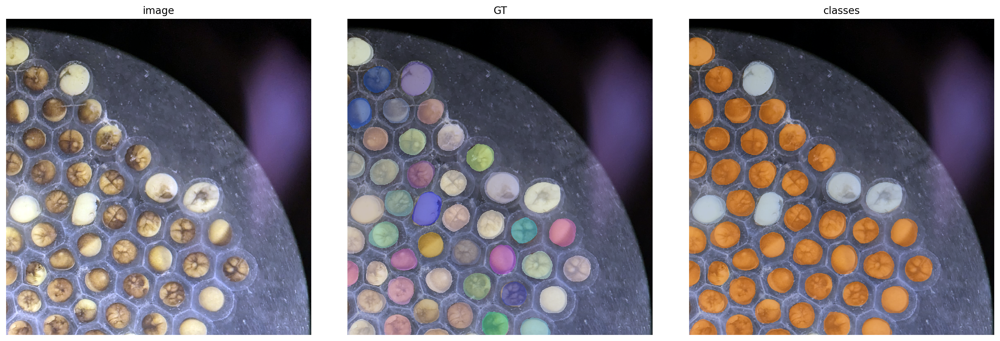

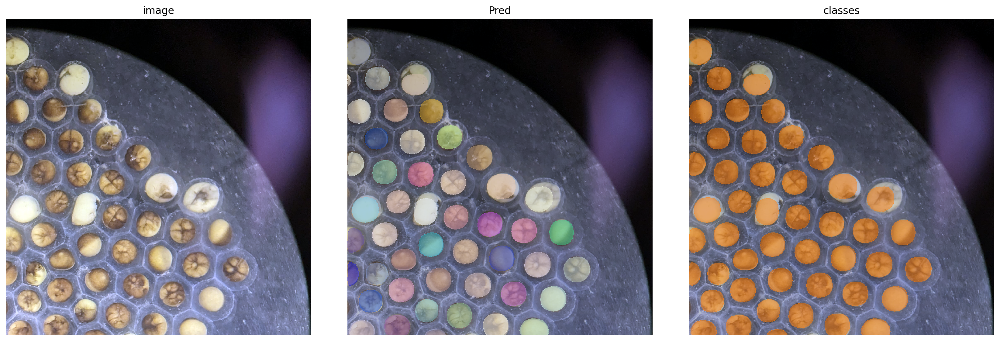

In [23]:
val_img =  X[i] if (X[i].ndim==2 or X[i].shape[-1]==3) else X[i][...,0]
plot_img_label(val_img, Y[i], list_of_dicts[i],            lbl_title="GT")
plot_img_label(val_img, label,    class_from_res(res), lbl_title="Pred"); 

In [19]:
from collections import Counter

gt = Counter(list_of_dicts[i].values())

result = Counter(class_from_res(res).values())

print("ground truth : " , gt)
print("pred : " , result)


ground truth Counter({2: 41, 1: 6})
pred :  Counter({2: 44, 1: 5})


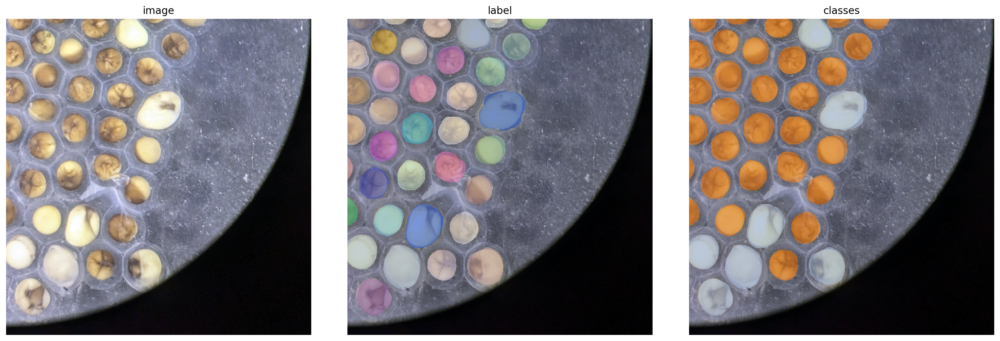

In [37]:
i = min(8, len(X)-1)

img, lbl, cls = X[3], Y[3], list_of_dicts[3]
assert img.ndim in (2,3)
img = img if (img.ndim==2 or img.shape[-1]==3) else img[...,0]
plot_img_label(img,lbl, cls)
None; 

In [129]:
if use_gpu:
    from csbdeep.utils.tf import limit_gpu_memory
    limit_gpu_memory(None, allow_growth=True)
    # alternatively, adjust as necessary: limit GPU memory to be used by TensorFlow to leave some to OpenCL-based computations
    # limit_gpu_memory(0.8)    

In [132]:
median_size = calculate_extents(list(Y), np.median)
fov = np.array(model._axes_tile_overlap('YX'))
print(f"median object size:      {median_size}")
print(f"network field of view :  {fov}")
if any(median_size > fov):
    print("WARNING: median object size larger than field of view of the neural network.")

median object size:      [115. 114.]
network field of view :  [94 94]


In [133]:
def random_fliprot(img, mask): 
    assert img.ndim >= mask.ndim
    axes = tuple(range(mask.ndim))
    perm = tuple(np.random.permutation(axes))
    img = img.transpose(perm + tuple(range(mask.ndim, img.ndim))) 
    mask = mask.transpose(perm) 
    for ax in axes: 
        if np.random.rand() > 0.5:
            img = np.flip(img, axis=ax)
            mask = np.flip(mask, axis=ax)
    return img, mask 

def random_intensity_change(img):
    img = img*np.random.uniform(0.6,2) + np.random.uniform(-0.2,0.2)
    return img


def augmenter(x, y):
    """Augmentation of a single input/label image pair.
    x is an input image
    y is the corresponding ground-truth label image
    """
    x, y = random_fliprot(x, y)
    x = random_intensity_change(x)
    # add some gaussian noise
    sig = 0.02*np.random.uniform(0,1)
    x = x + sig*np.random.normal(0,1,x.shape)
    return x, y

In [ ]:
# plot some augmented examples
img, lbl, cls = X[0], Y[0], list_of_dicts[0]
img = img if (img.ndim==2 or img.shape[-1]==3) else img[...,0]
plot_img_label(img,lbl,cls, n_classes=n_classes)
for _ in range(3):
    img_aug, lbl_aug = augmenter(img,lbl)
    plot_img_label(img_aug,lbl_aug,cls, img_title="image augmented", lbl_title="label augmented", n_classes=n_classes)
None; 

In [142]:
X_trn, X_val, Y_trn, Y_val, C_trn, C_val = train_test_split(X,Y,list_of_dicts,test_size=.20,random_state = 42)

In [143]:
model.train(X_trn,Y_trn, classes=C_trn, validation_data=(X_val,Y_val,C_val), augmenter=augmenter, epochs=2) # 200 epochs seem to be enough for synthetic demo dataset

cache.py (495): Non-empty compiler output encountered. Set the environment variable PYOPENCL_COMPILER_OUTPUT=1 to see more.


Epoch 1/2
100/100 [==============================] - 97s 946ms/step - loss: 8.0327 - prob_loss: 0.5449 - dist_loss: 32.0990 - prob_class_loss: 1.0680 - prob_kld: 0.3213 - dist_relevant_mae: 32.0980 - dist_relevant_mse: 1661.7812 - dist_dist_iou_metric: 0.1324 - val_loss: 4.0689 - val_prob_loss: 0.4770 - val_dist_loss: 15.5302 - val_prob_class_loss: 0.4859 - val_prob_kld: 0.2844 - val_dist_relevant_mae: 15.5284 - val_dist_relevant_mse: 415.6831 - val_dist_dist_iou_metric: 0.4007 - lr: 3.0000e-04
Epoch 2/2
100/100 [==============================] - 96s 958ms/step - loss: 4.7028 - prob_loss: 0.3709 - dist_loss: 18.4037 - prob_class_loss: 0.6511 - prob_kld: 0.1587 - dist_relevant_mae: 18.4017 - dist_relevant_mse: 621.7467 - dist_dist_iou_metric: 0.3646 - val_loss: 3.4237 - val_prob_loss: 0.2488 - val_dist_loss: 15.1022 - val_prob_class_loss: 0.1545 - val_prob_kld: 0.0562 - val_dist_relevant_mae: 15.1002 - val_dist_relevant_mse: 370.2949 - val_dist_dist_iou_metric: 0.4417 - lr: 3.0000e-04



In [144]:
model.optimize_thresholds(X_val, Y_val)

NMS threshold = 0.5:  75%|███████▌  | 15/20 [01:11<00:23,  4.75s/it, 0.462 -> 0.086]


Using optimized values: prob_thresh=0.452341, nms_thresh=0.3.
Saving to 'thresholds.json'.


{'prob': 0.4523405368435408, 'nms': 0.3}

In [48]:
i = 1
label, res = model.predict_instances(X[i], n_tiles=model._guess_n_tiles(X[i]))

100%|██████████| 9/9 [00:03<00:00,  2.70it/s]


In [49]:
def class_from_res(res):
    cls_dict = dict((i+1,c) for i,c in enumerate(res['class_id']))
    return cls_dict

print(class_from_res(res))

{1: 2, 2: 2, 3: 2, 4: 2, 5: 2, 6: 2, 7: 2, 8: 2, 9: 2, 10: 2, 11: 2, 12: 2, 13: 2, 14: 2, 15: 2, 16: 2, 17: 2, 18: 2, 19: 2, 20: 2, 21: 2, 22: 2, 23: 2, 24: 2, 25: 2, 26: 2, 27: 2, 28: 2, 29: 2, 30: 2, 31: 2, 32: 2, 33: 2, 34: 2, 35: 2, 36: 2, 37: 2, 38: 2, 39: 2, 40: 2, 41: 2, 42: 2, 43: 2, 44: 2, 45: 2, 46: 2, 47: 2}


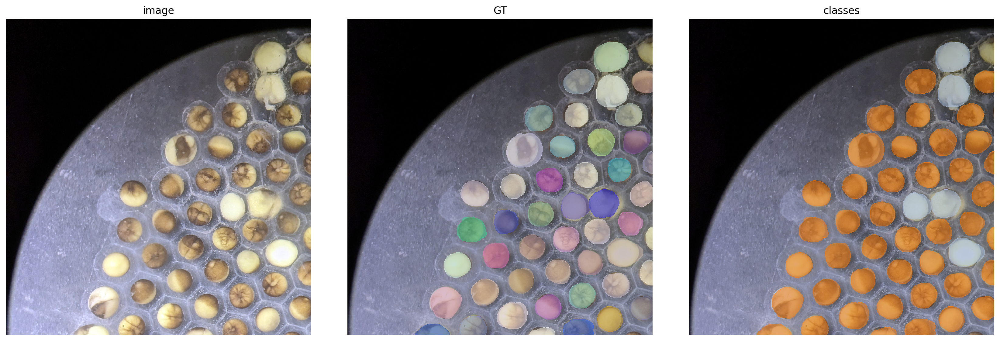

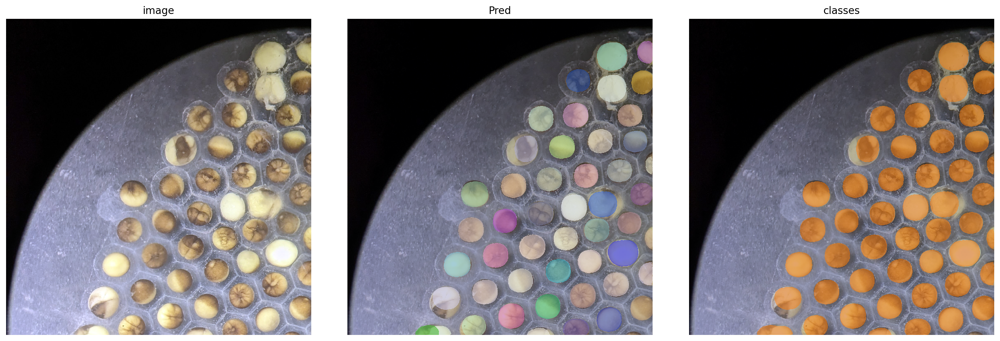

In [46]:
val_img =  X[i] if (X[i].ndim==2 or X[i].shape[-1]==3) else X[i][...,0]
plot_img_label(val_img, Y[i], list_of_dicts[i],            lbl_title="GT")
plot_img_label(val_img, label,    class_from_res(res), lbl_title="Pred"); 

In [44]:
Y_val_pred, res_val_pred = tuple(zip(*[model.predict_instances(x, n_tiles=model._guess_n_tiles(x), show_tile_progress=False)
              for x in tqdm(X_val[:])]))

NameError: name 'X_val' is not defined

In [146]:
stats = matching_dataset(Y_val, Y_val_pred, thresh=.5, show_progress=False)
print(stats)

DatasetMatching(criterion='iou', thresh=0.5, fp=1050, tp=91, fn=451, precision=0.07975460122699386, recall=0.16789667896678967, accuracy=0.0571608040201005, f1=0.1081402257872846, n_true=542, n_pred=1141, mean_true_score=0.10055160522460938, mean_matched_score=0.5988897805685526, panoptic_quality=0.0647640760923806, by_image=False)


In [ ]:
accuracies = []
total_pixels = 0
correct_predictions = 0
for true_class, pred_class in zip(Y_val,res_val_pred):
    total_pixels += np.sum(true_class != 0)
    correct_predictions += np.sum((true_class == pred_class) & (true_class != 0) & (true_class != -1))

accuracy = correct_predictions / total_pixels
accuracies.append(accuracy)

accuracies

In [ ]:
i = 1
plot_img_label(X_val[i],Y_val[i],      C_val[i],                        lbl_title="label GT")
plot_img_label(X_val[i],Y_val_pred[i], class_from_res(res_val_pred[i]), lbl_title="label Pred")

In [ ]:
os.path.dirname(__file__)